In [1]:
%load_ext autoreload
%autoreload 2

# XAI for Affective Computing LIME Tutorial

## Explainable Facial Expression Recognition with LIME

In this notebook, we will attempt to explain predictions of two Facial Expression recognition models, trained using a subset of the [AffectNet dataset](http://mohammadmahoor.com/affectnet/). AffectNet is a dataset of facial expressions in the wild, and the current subset has 8 facial expression categories: **Neutral, Happy, Sad, Surprise, Fear, Disgust, Anger, and Contempt**. (If interested, have a look at the paper for full details on the main dataset https://arxiv.org/abs/1708.03985).

First, we will learn to generate LIME explanations for an existing Convolutional Neural Network trained on raw face images, using the LIME Image Explainer.  Then, we will learn to generate LIME explanations for a pretrained Random Decision Forest trained on [Facial Action Units](https://imotions.com/blog/facial-action-coding-system/) that were extracted from the images using [OpenFace2.0](https://github.com/TadasBaltrusaitis/OpenFace). 

See **README.md** to get started with the Notebook installation and setup.

**First import the necessary packages for Part 1.**

In [1]:
import pickle
from pathlib import Path

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

# import tensorflow for model loading
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

# import sklearn for processing data and results
from sklearn.metrics import confusion_matrix, classification_report, auc, roc_curve, roc_auc_score
from sklearn.preprocessing import LabelBinarizer

# import model loading function
from model import cnn_model

from IPython.display import clear_output
import warnings
warnings.filterwarnings('ignore')

**Defines some functions to help load and display images**

In [2]:
# Helper Functions
def display_one_image(image, title, subplot, color='black', mask=None):
    plt.subplot(subplot)
    plt.axis('off')
    plt.imshow(image, )
    plt.title(title, fontsize=16)
    
def display_nine_images(images, titles, preds, start, title_colors=None):
    subplot = 331
    plt.figure(figsize=(13,13))
    for i in range(9):
        color = 'black' if title_colors is None else title_colors[i]
        idx = start+i
        display_one_image(images[idx], f'Actual={titles[idx]} \n Pred={preds[idx]} \n Index = {idx}', 331+i, color)
    # plt.tight_layout()
    plt.subplots_adjust(wspace=0.1, hspace=0.4)
    plt.show()

def image_title(label, prediction):
  # Both prediction (probabilities) and label (one-hot) are arrays with one item per class.
    class_idx = np.argmax(label, axis=-1)
    prediction_idx = np.argmax(prediction, axis=-1)
    if class_idx == prediction_idx:
        return f'{CLASS_LABELS[prediction_idx]} [correct]', 'black'
    else:
        return f'{CLASS_LABELS[prediction_idx]} [incorrect, should be {CLASS_LABELS[class_idx]}]', 'red'

def get_titles(images, labels, model):
    predictions = model.predict(images)
    titles, colors = [], []
    for label, prediction in zip(classes, predictions):
        title, color = image_title(label, prediction)
        titles.append(title)
        colors.append(color)
    return titles, colors

## Local Explations of Facial Expression Recognition with Images

### Setup

In [3]:
# Set our global variables
SEED = 12
IMG_HEIGHT = 128
IMG_WIDTH = 128
BATCH_SIZE = 80
NUM_CLASSES = 8
CLASS_LABELS = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']

#### Load Pretrained CNN Model and Setup Data Generator

For this example, we will use pretrained Tensorflow architecture (see this [Kaggle Notebook](https://www.kaggle.com/code/davidjo/emotion-recognition) with AffectNet data examples.  Since LIME is model agnostic, you can replace `model_xai` with any prediction function, and replace `images` and `classes` with any image dataset (we'll look at Tabular data later in the Notebook)

In [4]:
# make sure you've downloaded the models from LernraumPlus (see README instructions for Notebook I)
model_path = 'models/affectnet_model_e=60/affectnet_model'

# test loading weights
model_xai = cnn_model(input_shape=(IMG_HEIGHT, IMG_WIDTH, 3), num_classes=NUM_CLASSES)
model_xai.load_weights(model_path)

2022-11-11 12:17:32.721654: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [5]:
test_dir = 'data/affectnet/val_class/'

# Load data
test_datagen = ImageDataGenerator(validation_split=0.2,
                                  rescale=1./255)
test_gen = test_datagen.flow_from_directory(directory=test_dir,
                                            target_size=(IMG_HEIGHT, IMG_WIDTH),
                                            batch_size=BATCH_SIZE,
                                            shuffle=False,
                                            color_mode='rgb',
                                            class_mode='categorical', 
                                            seed = SEED)
images, classes = next(test_gen)

Found 80 images belonging to 8 classes.


#### Validate Loaded Model
Here we evaluate the loaded model to ensure it is working as expected.  You should get around $55\%$ accuracy. While this is not a perfect classifier is well above random guessing which is $1 / 8 * 100 = 12.5$ accuracy

Then we load predictions to use throughout the notebook. 

The predictions results can then be viewed with a confusion matrix to see where the model is confused.

In [6]:
loss, acc = model_xai.evaluate(test_gen, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

1/1 - 3s - loss: 1.5129 - accuracy: 0.5500 - 3s/epoch - 3s/step
Restored model, accuracy: 55.00%


In [7]:
# get softmax predictions from model
preds = model_xai(images)

# convert predictions to integers
y_pred = np.argmax(preds, axis=-1)
y_true = np.argmax(classes, axis=-1)

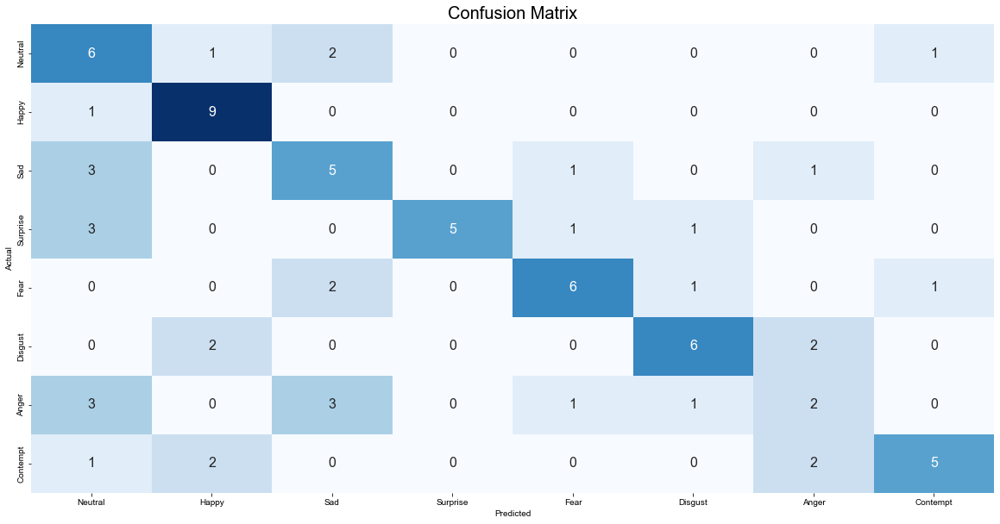

In [8]:
# we can also review the confusion matrix
cm_data = confusion_matrix(y_true, y_pred)
cm = pd.DataFrame(cm_data, columns=CLASS_LABELS, index = CLASS_LABELS)
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (20,10))
plt.title('Confusion Matrix', fontsize = 20)
sns.set(font_scale=1.2)
ax = sns.heatmap(cm, cbar=False, cmap="Blues", annot=True, annot_kws={"size": 16}, fmt='g')

### General LIME Explanations

Now that we have our model setup, we will review the images and predictions to identify a few data instances to explain.  

#### Explore Images
- Try changing start value to get a new set of images (there are 10 images for each class, so for example, the class happy will be at indexes 10-19)
- Search through the images to find at least 4 to explain 
    - Find classes that you would like to explain, and from each class select 2 images
        - one should be a correct prediction  
        - and one should be an incorrect prediction

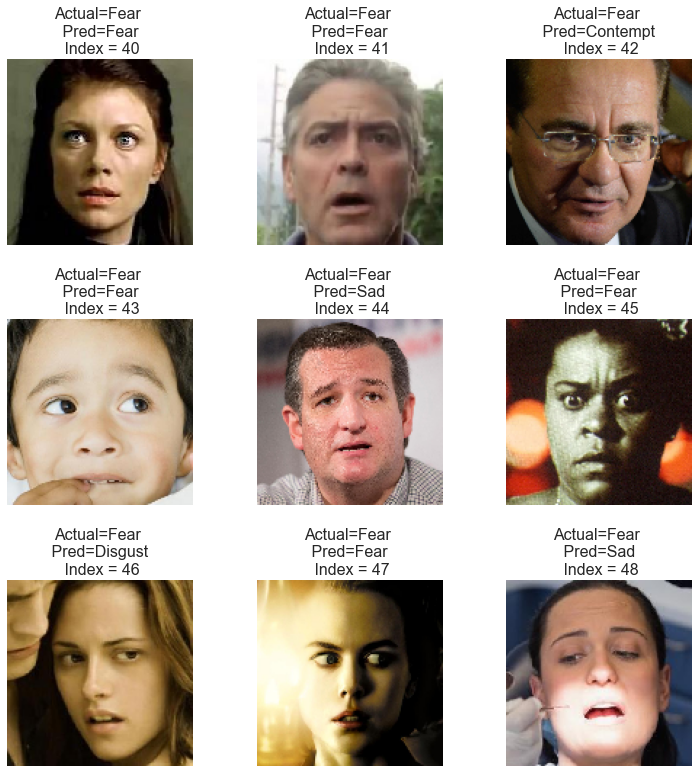

In [9]:
# displays first 9 images in array
start = 40

true_labels = [CLASS_LABELS[idx] for idx in y_true]
pred_labels = [CLASS_LABELS[idx] for idx in y_pred]
display_nine_images(images, true_labels, pred_labels, start)

In [10]:
#### Images for Explanantions ####
# we will use this array later in this task
img_idxs = [45, 46, 62, 68]

#### Implement a LIME Image Explainer

Now we we implement a [LimeImageExplainer](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_image) instance, you can review the [LIME tutorial](https://github.com/marcotcr/lime/blob/master/doc/notebooks/Tutorial%20-%20Image%20Classification%20Keras.ipynb) for more details. 

In [11]:
import lime
from lime import lime_image
from lime.wrappers.scikit_image import SegmentationAlgorithm

from skimage.segmentation import mark_boundaries # used to get boundries from explanation for plotting

In [12]:
####### LIME Explainer ########

# implement Lime Image Explainer object
explainer = lime_image.LimeImageExplainer(verbose = False)

# LIME doesn't work on pixel values directly but rather on superpixels.  
# For expression recognition, however, the segmentation algorithm is very important
# so this might take some experimentation to identify the proper hyperparameters
segmenter = SegmentationAlgorithm('slic', n_segments=100, compactness=1, sigma=1)

# for each image generate an explanation based on our classifier function `model_xai`
explanations = []
for idx in img_idxs:
    explanation = explainer.explain_instance(images[idx], 
                                             classifier_fn = model_xai, 
                                             top_labels=3, hide_color=0, num_samples=1000, segmentation_fn=segmenter)
    explanations.append(explanation)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:27<00:00, 36.80it/s]


Here we simply view the top predictions from the explanation to verify the data.

In [13]:
## Print predicted classes from the explanations
for idx, explanation in zip(img_idxs, explanations):
    
    print(f'Explanation Predictions for Index {idx}')
    
    top_classes = [CLASS_LABELS[i] for i in explanation.top_labels]
    print(f'Top Classes: {top_classes}')

    actual_class = CLASS_LABELS[y_true[idx]]
    print(f'Actual Class: {actual_class}')
    print()

Explanation Predictions for Index 45
Top Classes: ['Fear', 'Surprise', 'Anger']
Actual Class: Fear

Explanation Predictions for Index 46
Top Classes: ['Disgust', 'Anger', 'Fear']
Actual Class: Fear

Explanation Predictions for Index 62
Top Classes: ['Anger', 'Disgust', 'Sad']
Actual Class: Anger

Explanation Predictions for Index 68
Top Classes: ['Sad', 'Anger', 'Disgust']
Actual Class: Anger



#### Visualize Explanations
Now we visualize the explanations for each of the 4 data points from LIME using matplotlib's `imshow` function  via the helper functions above. With each cell, we explore some of the different explanation parameters

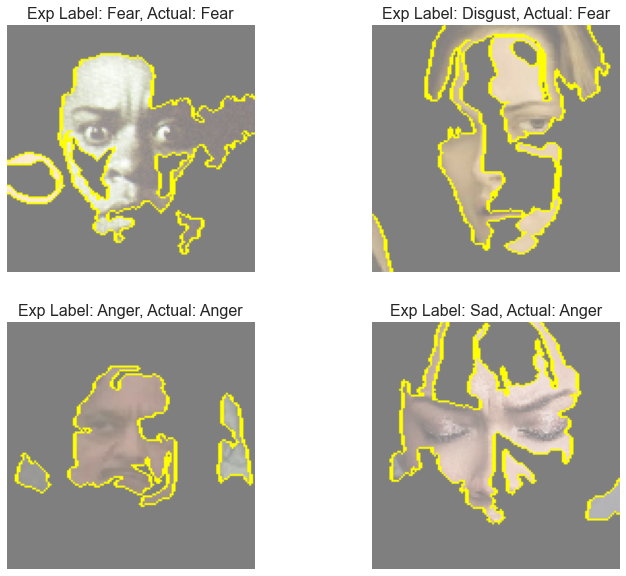

In [14]:
# Visualize LIME Explanations #
###############################

# in this cell we are viewing postively contributing superpixels for the top label 
# (try playing with some hyperparameters to get different visualizations)

plt.figure(figsize=(12, 10))
base_plot = 221
for i, (idx, explanation) in enumerate(zip(img_idxs, explanations)):
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=10, hide_rest=True)
    title = f'Exp Label: {CLASS_LABELS[explanation.top_labels[0]]}, Actual: {CLASS_LABELS[y_true[idx]]}'
    display_one_image(mark_boundaries(temp / 2 + 0.5, mask), title, base_plot+i)

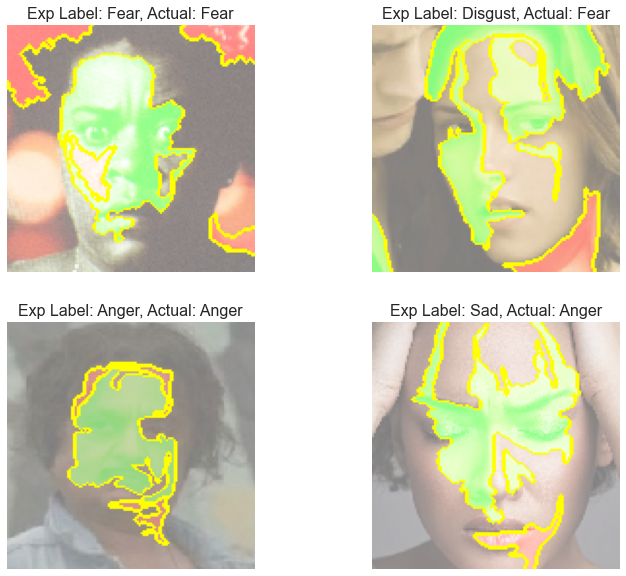

In [15]:
# in this cell we are viewing postively and negatively contributing superpixels for the top label 

plt.figure(figsize=(12, 10))
base_plot = 221
for i, (idx, explanation) in enumerate(zip(img_idxs, explanations)):
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)
    title = f'Exp Label: {CLASS_LABELS[explanation.top_labels[0]]}, Actual: {CLASS_LABELS[y_true[idx]]}'
    display_one_image(mark_boundaries(temp / 2 + 0.5, mask), title, base_plot+i)

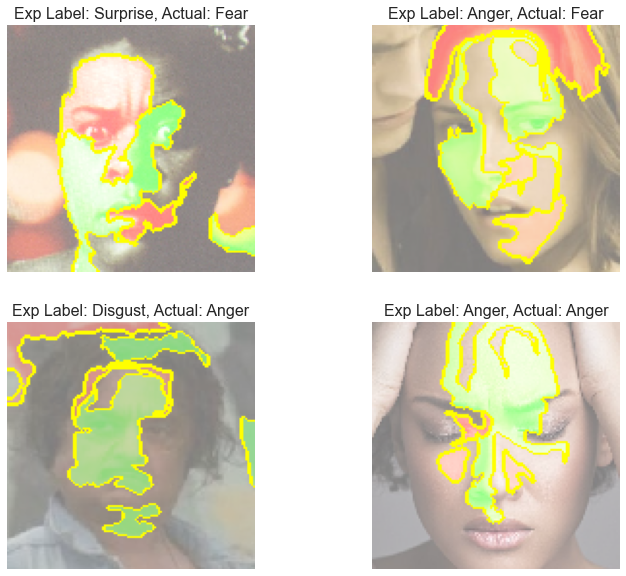

In [16]:
# now we can try visualizing the second or third top prediction
exp_label = 1

plt.figure(figsize=(12, 10))
base_plot = 221
for i, (idx, explanation) in enumerate(zip(img_idxs, explanations)):
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[exp_label], positive_only=False, num_features=10, hide_rest=False)
    title = f'Exp Label: {CLASS_LABELS[explanation.top_labels[exp_label]]}, Actual: {CLASS_LABELS[y_true[idx]]}'
    display_one_image(mark_boundaries(temp / 2 + 0.5, mask), title, base_plot+i)

## Local and Global Explanations of Tabular Data with LIME Submodular Pick

Now let's have a look at using LIME's submodular pick (SP-LIME).  The goal of SP-LIME is to identify a set of data instances that maximize the coverage of the explanations.  So the SP-LIME module will identify $N$ instances to explain, then you can plot the explanations.  

Unfortunately, SP-LIME does not work with raw images, so now we will work with a dataset of [Facial Action Units](https://imotions.com/blog/facial-action-coding-system/) extracted from the AffectNet dataset using [OpenFace2.0](https://github.com/TadasBaltrusaitis/OpenFace). In this way, we can now apply SP-LIME to our dataset. 

In this section, we will now use a pretrained [Random Decision Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html) as our classifier instead of a Deep Neural Network.  

### Setup

#### Load the data

In [17]:
# Full data from training and evaluation
train_csv = 'data/affectnet_aus/train_aus.csv'
val_csv = 'data/affectnet_aus/val_aus.csv'

# load training and validation data as pandas dataframeas
df_train = pd.read_csv(train_csv)
df_val = pd.read_csv(val_csv)

# smaller dataset for explanations (same data as in Task 1)
xai_csv = 'data/affectnet_aus/eval_aus.csv'
df_xai = pd.read_csv(xai_csv)
df_xai['image'] = df_xai['image'].apply(lambda x: x.replace('../data', 'data'))

# get only the columns storing action units from the dataframe
feature_cols = [col for col in df_val if col.startswith('AU')]

CLASS_LABELS = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']  # same class labels as before

In [18]:
# convert data from dataframe to Numpy arrays

X_train = np.array(df_train.loc[:, feature_cols])
y_train = np.array(df_train['class'])

X_test = np.array(df_val.loc[:, feature_cols])
y_test = np.array(df_val['class'])

X_xai = np.array(df_xai.loc[:, feature_cols])
y_xai = np.array(df_xai['class'])

print('Train', X_train.shape, y_train.shape)
print('Test', X_test.shape, y_test.shape)
print('XAI', X_xai.shape, y_xai.shape)

Train (36685, 35) (36685,)
Test (3908, 35) (3908,)
XAI (80, 35) (80,)


#### Load pretrained model
And validate that it works.  
The accuracy of the model should be around $99.65%$

You can replace `clf` with any model that takes tabular data as input

In [19]:
with open('models/affect_rdf.pkl', 'rb') as f:
    clf = pickle.load(f)
    
clf.score(X_train, y_train)

0.9965108354913452

#### Evaluate on full test data
Unfortunately, the accuracy is only $43\%$ but this is above chance guessing which would get $1 / 8 * 100 = 12.5%$ accuracy (since there are 8 total classes)

In [20]:
# get model predictions
y_test_preds = clf.predict(X_test)
y_test_true = y_test

In [21]:
print(classification_report(y_test_true, y_test_preds))

              precision    recall  f1-score   support

           0       0.32      0.41      0.36       485
           1       0.58      0.71      0.64       488
           2       0.38      0.38      0.38       490
           3       0.43      0.43      0.43       488
           4       0.50      0.48      0.49       487
           5       0.54      0.35      0.42       493
           6       0.37      0.46      0.41       482
           7       0.41      0.27      0.33       495

    accuracy                           0.44      3908
   macro avg       0.44      0.44      0.43      3908
weighted avg       0.44      0.44      0.43      3908



We can also review the confusion matrix to see where the model is confused

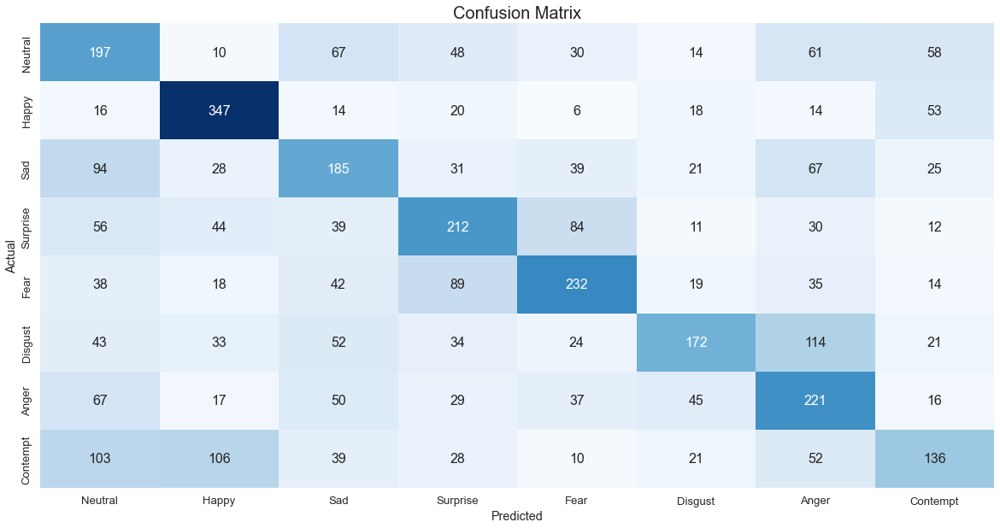

In [22]:
cm_data = confusion_matrix(y_test_true, y_test_preds)
cm = pd.DataFrame(cm_data, columns=CLASS_LABELS, index=CLASS_LABELS)
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (20,10))
plt.title('Confusion Matrix', fontsize = 20)
sns.set(font_scale=1.2)
ax = sns.heatmap(cm, cbar=False, cmap="Blues", annot=True, annot_kws={"size": 16}, fmt='g')

#### Evaluate on XAI Data
The XAI data is a subset of the test data

In [23]:
# get model predictions
y_xai_preds = clf.predict(X_xai)
y_xai_true = y_xai
print(classification_report(y_xai_true, y_xai_preds))

              precision    recall  f1-score   support

           0       0.21      0.40      0.28        10
           1       0.64      0.70      0.67        10
           2       0.67      0.40      0.50        10
           3       0.57      0.40      0.47        10
           4       0.46      0.60      0.52        10
           5       0.60      0.30      0.40        10
           6       0.23      0.30      0.26        10
           7       0.50      0.30      0.37        10

    accuracy                           0.42        80
   macro avg       0.48      0.43      0.43        80
weighted avg       0.48      0.42      0.43        80



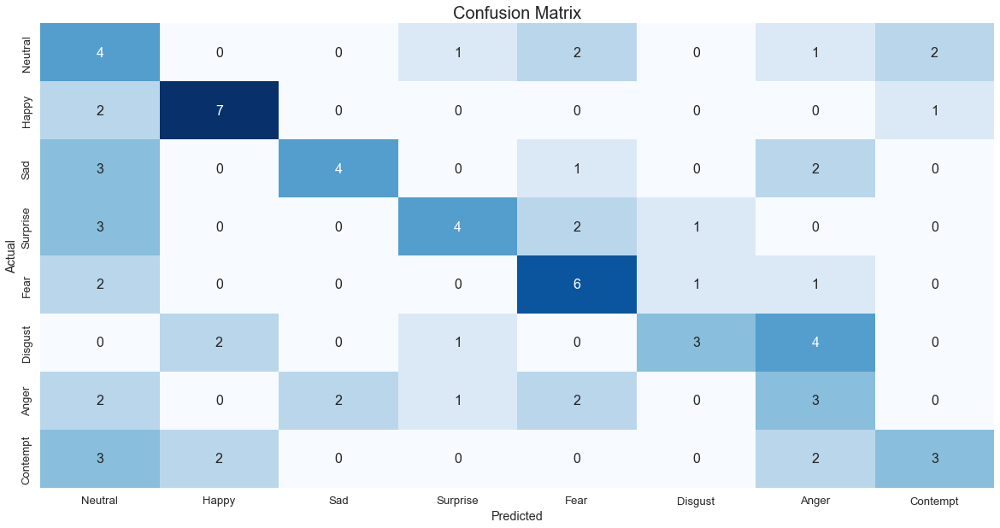

In [24]:
cm_data = confusion_matrix(y_xai_true, y_xai_preds)
cm = pd.DataFrame(cm_data, columns=CLASS_LABELS, index=CLASS_LABELS)
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
plt.figure(figsize = (20,10))
plt.title('Confusion Matrix', fontsize = 20)
sns.set(font_scale=1.2)
ax = sns.heatmap(cm, cbar=False, cmap="Blues", annot=True, annot_kws={"size": 16}, fmt='g')

###  General Local Explanations with LIME Tabular

#### Explore and Identify Images to Explain

In [25]:
# packages needed for the rest of the tasks
from skimage import io

import lime.lime_tabular

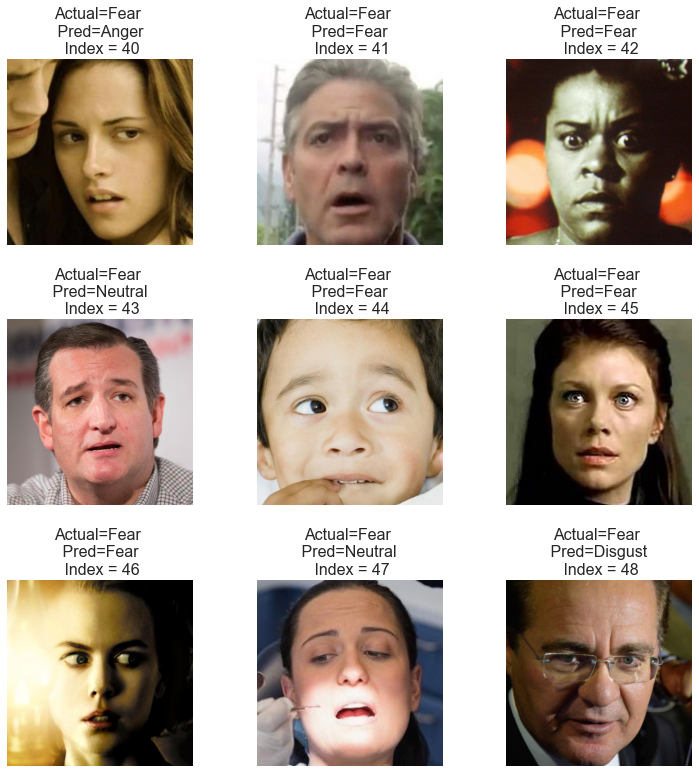

In [26]:
# displays first 9 images in array
start = 40

images = [io.imread(f) for f in df_xai.image]

true_labels = [CLASS_LABELS[idx] for idx in y_xai_true]
pred_labels = [CLASS_LABELS[idx] for idx in y_xai_preds]
display_nine_images(images, true_labels, pred_labels, start)

In [27]:
####### Image Indexes #########
###############################
img_idxs = [45, 46, 62, 68]

#### Implement Lime Tabular Explainer
Before getting to submodular pick we will need to define a Tabular Explainer. 

- [LimeTabularExplainer](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_tabular)
- [LIME tutorial](https://marcotcr.github.io/lime/tutorials/Tutorial%20-%20continuous%20and%20categorical%20features.html)

In [28]:
import lime.lime_tabular

In [29]:
###### Tabular Explainer ######
###############################
tab_explainer = lime.lime_tabular.LimeTabularExplainer(np.array(X_train), feature_names=feature_cols, class_names=CLASS_LABELS, discretize_continuous=True)

#### Visualize Local Explanations
Review at the previously identified 4 data instances from the `X_xai` dataset, by getting an explanation from the tabular explainer, and then plotting the explanations for each data instance (see tutorial mentioned above). 

In [30]:
#### Tabular Explanations #####
###############################
explanations = []
for idx in img_idxs:
    exp = tab_explainer.explain_instance(X_xai[idx], clf.predict_proba, num_features=5, top_labels=1)
    explanations.append(exp)

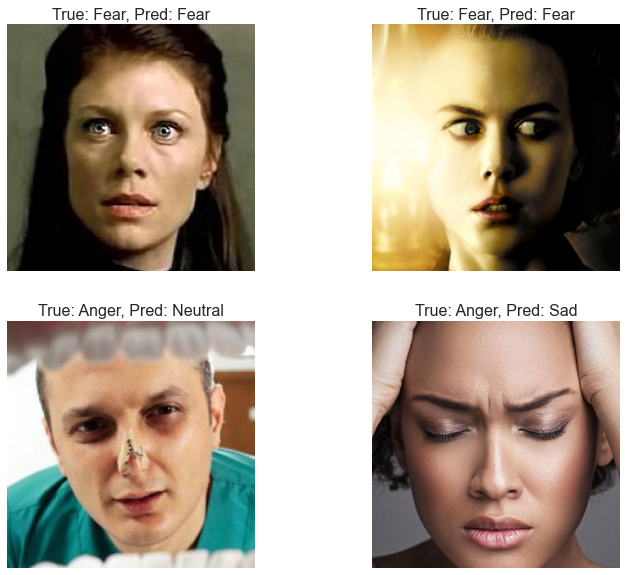

In [31]:
plt.figure(figsize=(12, 10))
for i, idx in enumerate(img_idxs):
    img = images[idx]
    true_label, pred_label = CLASS_LABELS[y_xai_true[idx]], CLASS_LABELS[y_xai_preds[idx]]
    title = f'True: {true_label}, Pred: {pred_label}'
    display_one_image(img, title, 221+i)

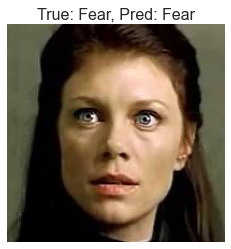

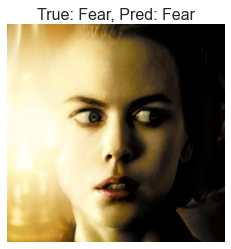

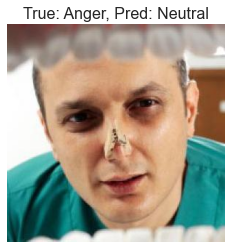

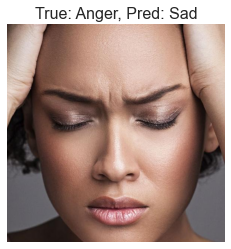

In [45]:
for i, exp in enumerate(explanations):
    idx = img_idxs[i]
    img = images[idx]
    true_label, pred_label = CLASS_LABELS[y_xai_true[idx]], CLASS_LABELS[y_xai_preds[idx]]
    title = f'True: {true_label}, Pred: {pred_label}'
    display_one_image(img, title, 111)
    plt.show()
    exp.show_in_notebook(show_table=True, show_all=False)

### Generate Global Explanations with Submodular Pick

Now we implement a [Submodular Pick](https://lime-ml.readthedocs.io/en/latest/lime.html#lime-submodular-pick-module) instance to get try to gain a global perspective of how the model makes decisions.

- [LIME tutorial](https://github.com/marcotcr/lime/blob/master/doc/notebooks/Submodular%20Pick%20examples.ipynb)

In [33]:
from lime import submodular_pick
from skimage import io

In [34]:
########### SP LIME ###########
###############################
sp = submodular_pick.SubmodularPick(tab_explainer, X_train, clf.predict_proba, sample_size=20, num_features=5, num_exps_desired=len(CLASS_LABELS) * 2)

#### Visualize the Explanations
The resulting explanations are based on instances selected through submodular pick, which attempts to maximize the coverage of explanations over the features.

In [36]:
########## Visulize ###########
###############################
[exp.show_in_notebook(show_table=True, show_all=False) for exp in sp.sp_explanations];